In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
fe = fm.FontEntry(
    fname=r'/usr/share/fonts/truetype/nanum/NanumGothic.ttf', # ttf 파일이 저장되어 있는 경로
    name='NanumGothic'
)
fm.fontManager.ttflist.insert(0, fe)
plt.rcParams.update({'font.size' : 10, 'font.family' : 'NanumGothic'})
plt.rc('font', family='NanumGothic')

import warnings
warnings.filterwarnings('ignore')

import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import datetime
from pathlib import Path

In [18]:
DATA = Path("../Data")

In [19]:
train = pd.read_csv(DATA / "fog_train_01.csv")

In [20]:
# 내륙, 내륙산간, 동해, 서해, 남해
train['지점번호1'], train['지점번호2'] = train['지점번호'].str.slice(0, 1), train['지점번호'].str.slice(1, 2)

In [21]:
def create_datetime_day(data):
    return  datetime.datetime(year=2024, month=data['월'], day=data['일'])

In [22]:
def create_datetime_hour(data):
    return  datetime.datetime(year=2024, month=data['월'], day=data['일'], hour=data["시간"])

In [23]:
def create_datetime_minute(data):
    return  datetime.datetime(year=2024, month=data['월'], day=data['일'], hour = data["시간"], minute=data["분"])

In [24]:
train["관측일자"] = train.apply(create_datetime_day, axis=1)
train["관측시간"] = train.apply(create_datetime_hour, axis=1)
train["관측시분"] = train.apply(create_datetime_minute, axis=1)

In [25]:
def make_season(month):
    if month >= 3 and month <= 5 :
        return '봄'
    
    elif month >= 6 and month <= 8 :
        return '여름'
    
    elif month >= 9 and month <= 11 :
        return '가을'
    
    else :
        return '겨울'

In [26]:
train["계절"] = train["월"].apply(make_season)

In [27]:
train

,년도,월,일,시간,분,지점번호,10분평균풍향,10분평균풍속,10분평균기온,강수유무,...,10분일사량합,10분평균지면온도,10분평균시정,시정구간,지점번호1,지점번호2,관측일자,관측시간,관측시분,계절
0,I,1,1,0,10,AA,0.0,0.0,-6.4,0.0,...,0.0,-2.8,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:10:00,겨울
1,I,1,1,0,20,AA,0.0,0.0,-6.3,0.0,...,0.0,-2.7,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:20:00,겨울
2,I,1,1,0,30,AA,0.0,0.0,-6.3,0.0,...,0.0,-2.6,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:30:00,겨울
3,I,1,1,0,40,AA,27.8,0.4,-6.2,0.0,...,0.0,-2.6,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:40:00,겨울
4,I,1,1,0,50,AA,59.7,0.5,-6.1,0.0,...,0.0,-2.5,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:50:00,겨울
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3156454,K,12,31,23,10,EC,305.3,7.7,2.5,0.0,...,0.0,-0.9,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:10:00,겨울
3156455,K,12,31,23,20,EC,293.8,5.7,2.3,0.0,...,0.0,-1.3,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:20:00,겨울
3156456,K,12,31,23,30,EC,274.2,4.9,2.2,0.0,...,0.0,-1.4,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:30:00,겨울
3156457,K,12,31,23,40,EC,270.3,4.6,2.1,0.0,...,0.0,-1.6,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:40:00,겨울


In [28]:
train_year_I = train[(train["년도"]=="I")]

In [29]:
train_year_I

,년도,월,일,시간,분,지점번호,10분평균풍향,10분평균풍속,10분평균기온,강수유무,...,10분일사량합,10분평균지면온도,10분평균시정,시정구간,지점번호1,지점번호2,관측일자,관측시간,관측시분,계절
0,I,1,1,0,10,AA,0.0,0.0,-6.4,0.0,...,0.0,-2.8,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:10:00,겨울
1,I,1,1,0,20,AA,0.0,0.0,-6.3,0.0,...,0.0,-2.7,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:20:00,겨울
2,I,1,1,0,30,AA,0.0,0.0,-6.3,0.0,...,0.0,-2.6,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:30:00,겨울
3,I,1,1,0,40,AA,27.8,0.4,-6.2,0.0,...,0.0,-2.6,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:40:00,겨울
4,I,1,1,0,50,AA,59.7,0.5,-6.1,0.0,...,0.0,-2.5,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:50:00,겨울
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1054055,I,12,31,23,10,EC,260.9,5.9,-0.3,0.0,...,0.0,-1.7,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:10:00,겨울
1054056,I,12,31,23,20,EC,264.3,5.5,-0.3,0.0,...,0.0,-1.7,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:20:00,겨울
1054057,I,12,31,23,30,EC,258.7,5.3,-0.2,0.0,...,0.0,-1.3,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:30:00,겨울
1054058,I,12,31,23,40,EC,263.6,5.7,-0.1,0.0,...,0.0,-1.1,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:40:00,겨울


In [30]:
columns = train_year_I.columns[6:14]
columns

Index(['10분평균풍향', '10분평균풍속', '10분평균기온', '강수유무', '10분평균상대습도', '10분일사량합',
       '10분평균지면온도', '10분평균시정'],
      dtype='object')

<Axes: title={'center': 'I 년도 10분평균풍향'}, xlabel='관측일자', ylabel='10분평균풍향'>

<Axes: title={'center': 'I 년도 10분평균풍속'}, xlabel='관측일자', ylabel='10분평균풍속'>

<Axes: title={'center': 'I 년도 10분평균기온'}, xlabel='관측일자', ylabel='10분평균기온'>

<Axes: title={'center': 'I 년도 강수유무'}, xlabel='관측일자', ylabel='강수유무'>

<Axes: title={'center': 'I 년도 10분평균상대습도'}, xlabel='관측일자', ylabel='10분평균상대습도'>

<Axes: title={'center': 'I 년도 10분일사량합'}, xlabel='관측일자', ylabel='10분일사량합'>

<Axes: title={'center': 'I 년도 10분평균지면온도'}, xlabel='관측일자', ylabel='10분평균지면온도'>

<Axes: title={'center': 'I 년도 10분평균시정'}, xlabel='관측일자', ylabel='10분평균시정'>

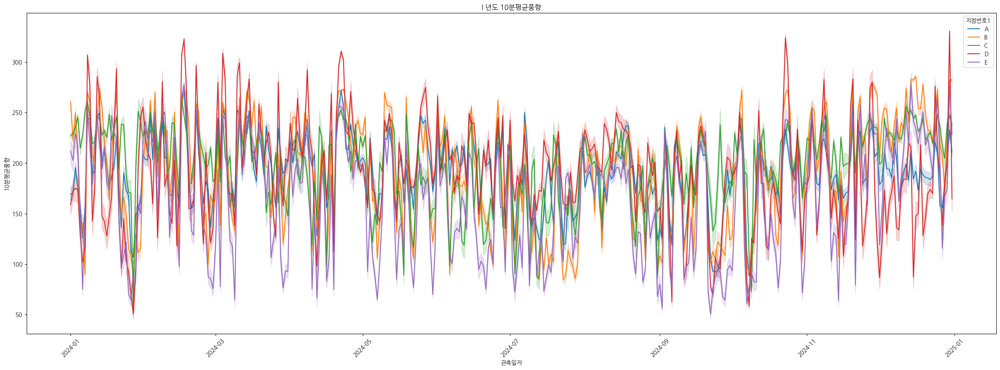

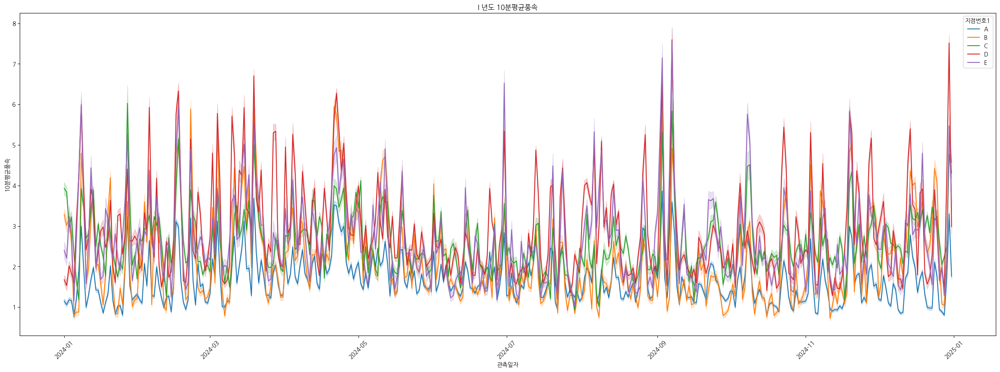

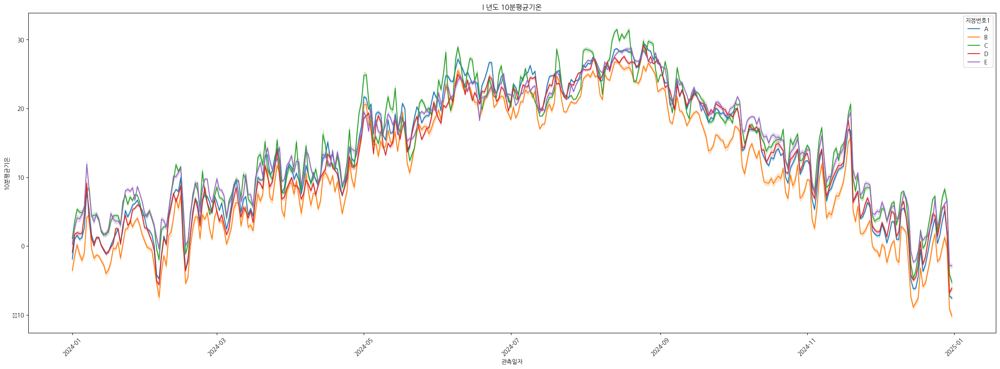

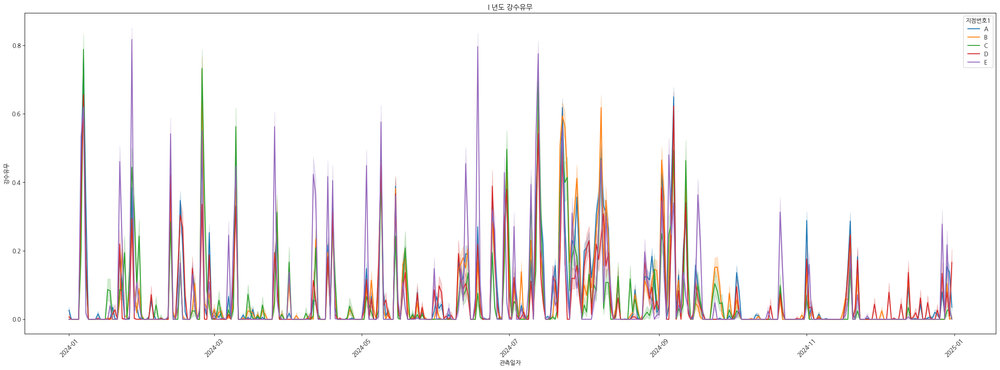

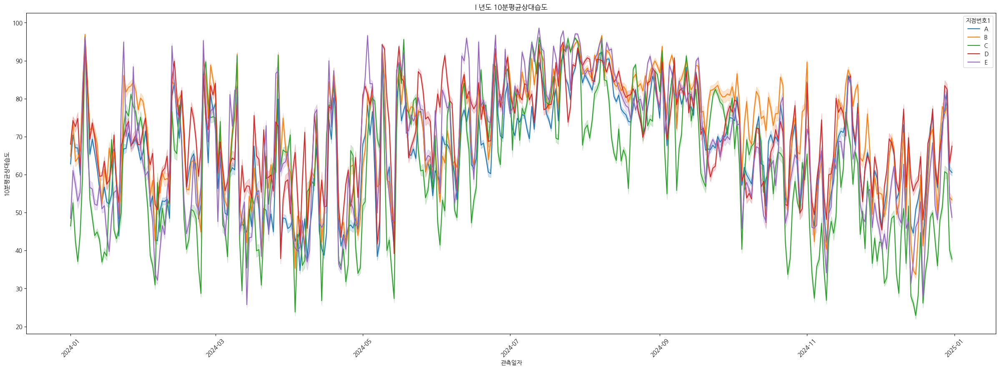

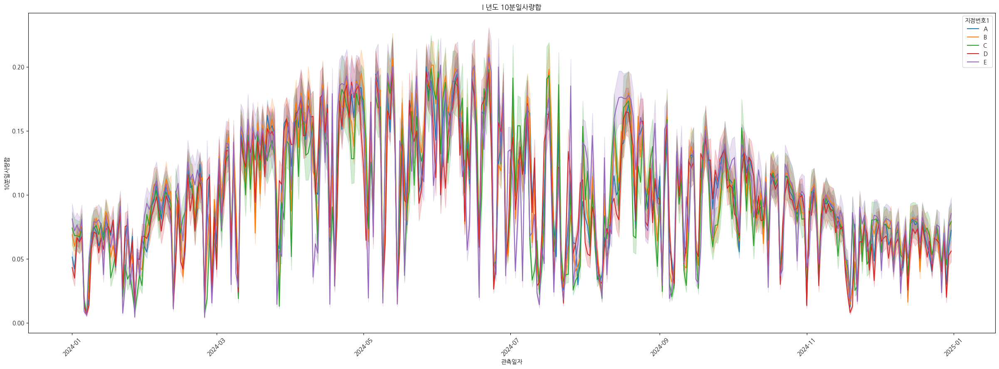

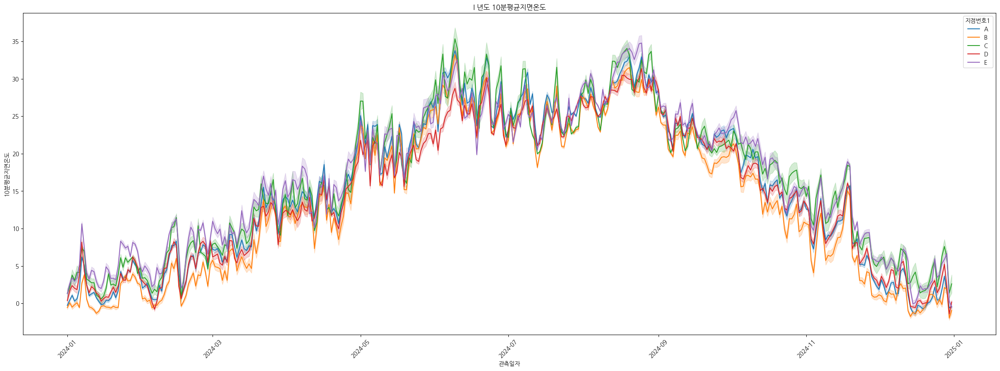

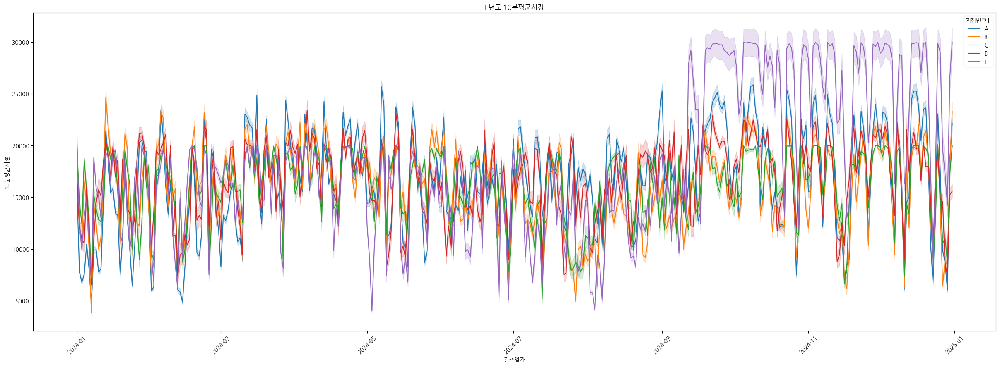

In [31]:
for col in columns :
    plt.figure(figsize=(30, 10))
    plt.title(f"I 년도 {col}")
    plt.xticks(rotation=45)
    display(sns.lineplot(train_year_I, x="관측일자", y=col, hue="지점번호1"))
    

<Axes: title={'center': 'I 년도10분평균풍향'}, xlabel='관측일자', ylabel='10분평균풍향'>

<Axes: title={'center': 'I 년도10분평균풍속'}, xlabel='관측일자', ylabel='10분평균풍속'>

<Axes: title={'center': 'I 년도10분평균기온'}, xlabel='관측일자', ylabel='10분평균기온'>

<Axes: title={'center': 'I 년도강수유무'}, xlabel='관측일자', ylabel='강수유무'>

<Axes: title={'center': 'I 년도10분평균상대습도'}, xlabel='관측일자', ylabel='10분평균상대습도'>

<Axes: title={'center': 'I 년도10분일사량합'}, xlabel='관측일자', ylabel='10분일사량합'>

<Axes: title={'center': 'I 년도10분평균지면온도'}, xlabel='관측일자', ylabel='10분평균지면온도'>

<Axes: title={'center': 'I 년도10분평균시정'}, xlabel='관측일자', ylabel='10분평균시정'>

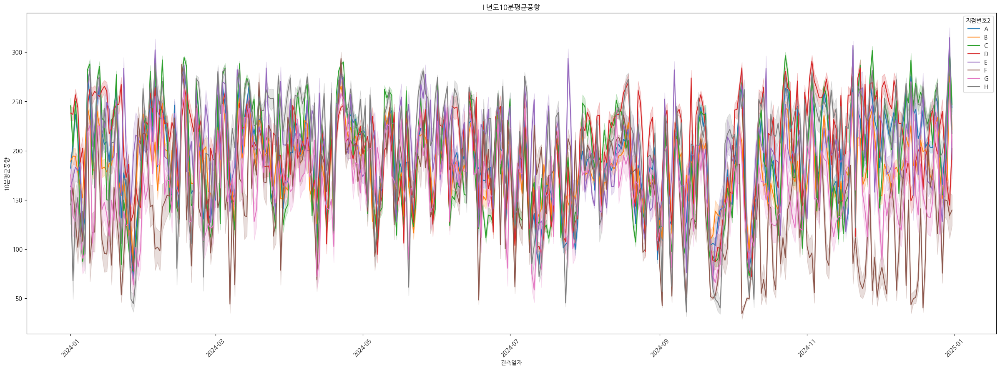

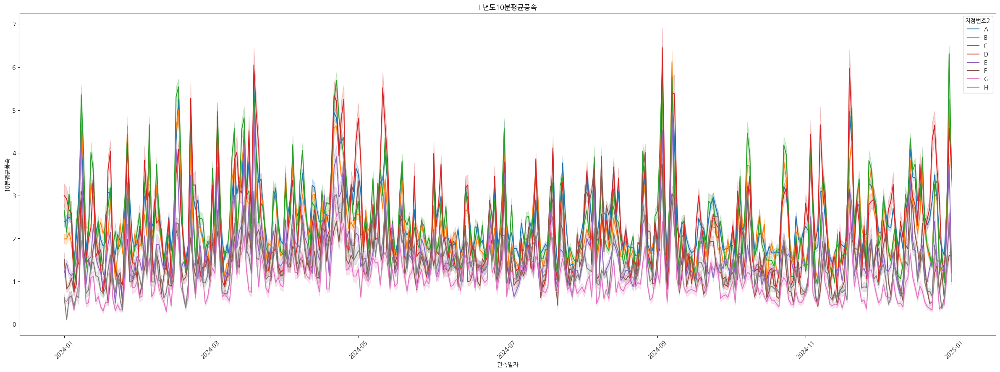

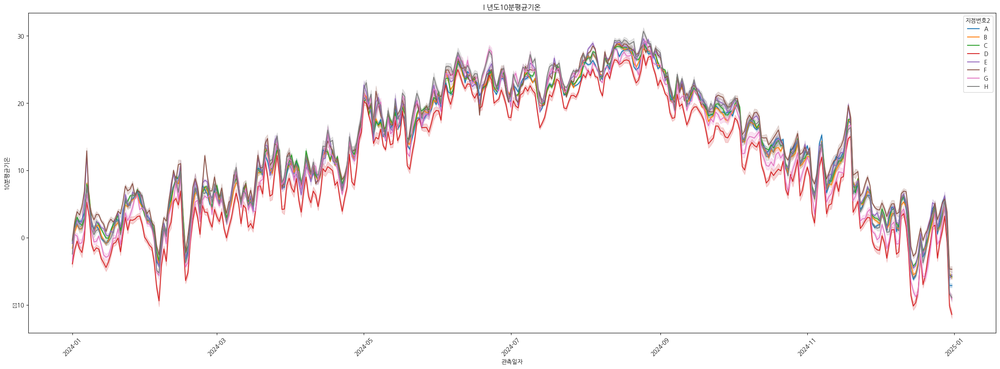

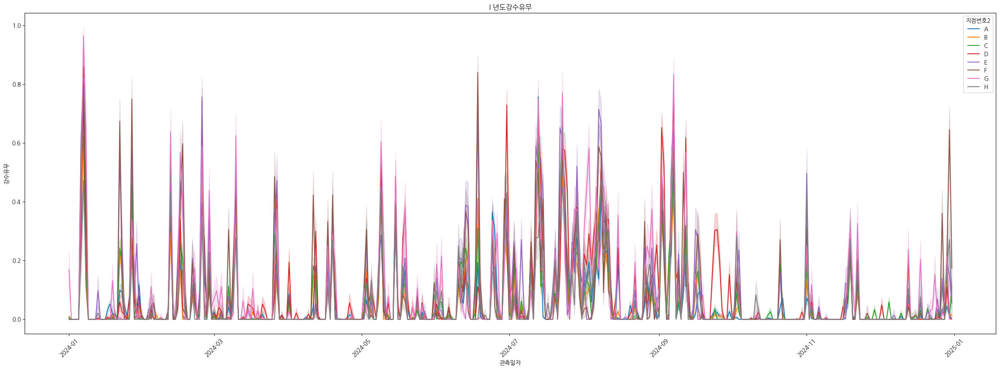

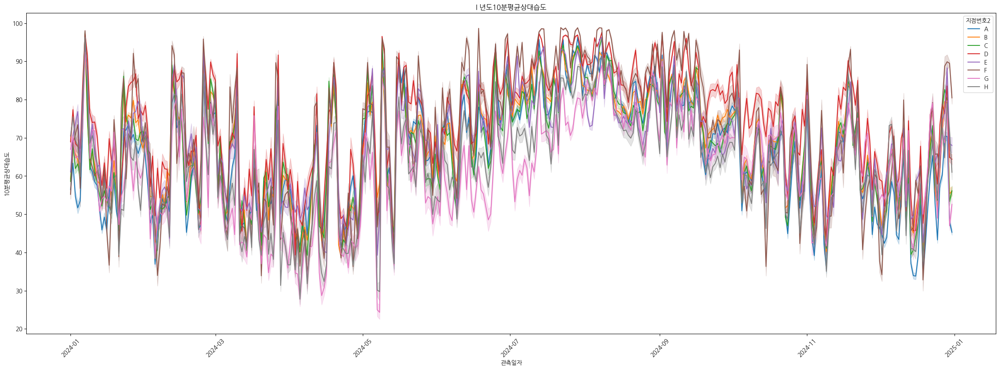

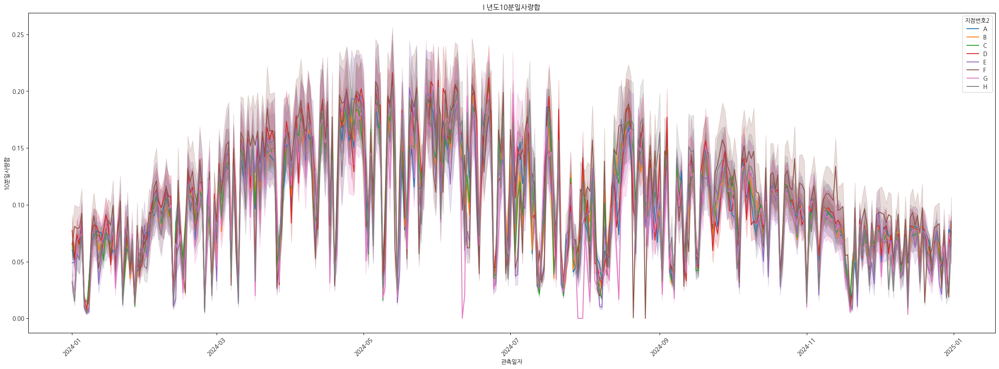

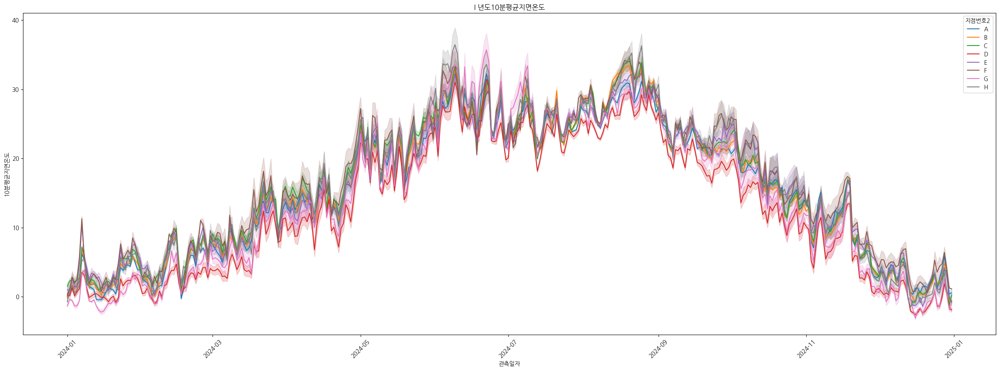

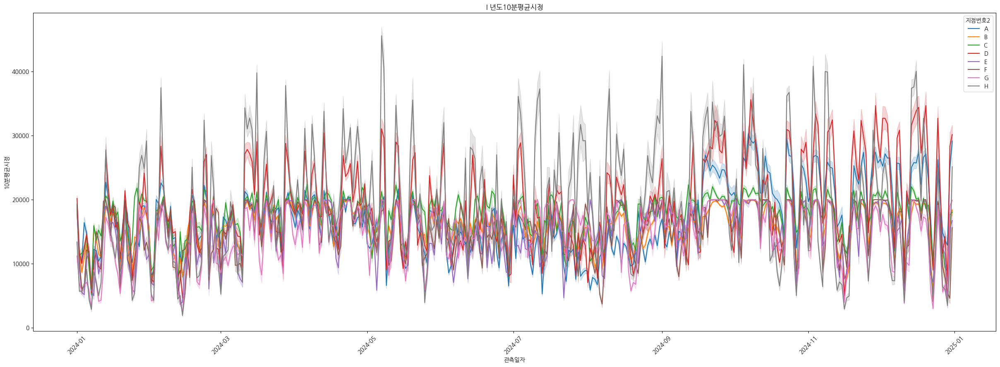

In [32]:
for col in columns :
    plt.figure(figsize=(30, 10))
    plt.xticks(rotation=45)
    plt.title(f"I 년도{col}")
    display(sns.lineplot(train_year_I, x="관측일자", y=col, hue="지점번호2"))

<Axes: title={'center': 'I년도 지점번호 A에 대한 10분평균풍향'}, xlabel='관측일자', ylabel='10분평균풍향'>

<Axes: title={'center': 'I년도 지점번호 A에 대한 10분평균풍속'}, xlabel='관측일자', ylabel='10분평균풍속'>

<Axes: title={'center': 'I년도 지점번호 A에 대한 10분평균기온'}, xlabel='관측일자', ylabel='10분평균기온'>

<Axes: title={'center': 'I년도 지점번호 A에 대한 강수유무'}, xlabel='관측일자', ylabel='강수유무'>

<Axes: title={'center': 'I년도 지점번호 A에 대한 10분평균상대습도'}, xlabel='관측일자', ylabel='10분평균상대습도'>

<Axes: title={'center': 'I년도 지점번호 A에 대한 10분일사량합'}, xlabel='관측일자', ylabel='10분일사량합'>

<Axes: title={'center': 'I년도 지점번호 A에 대한 10분평균지면온도'}, xlabel='관측일자', ylabel='10분평균지면온도'>

<Axes: title={'center': 'I년도 지점번호 A에 대한 10분평균시정'}, xlabel='관측일자', ylabel='10분평균시정'>

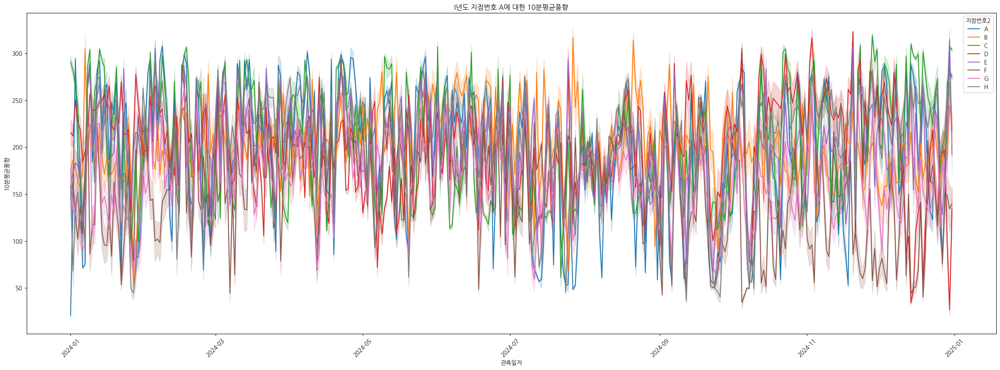

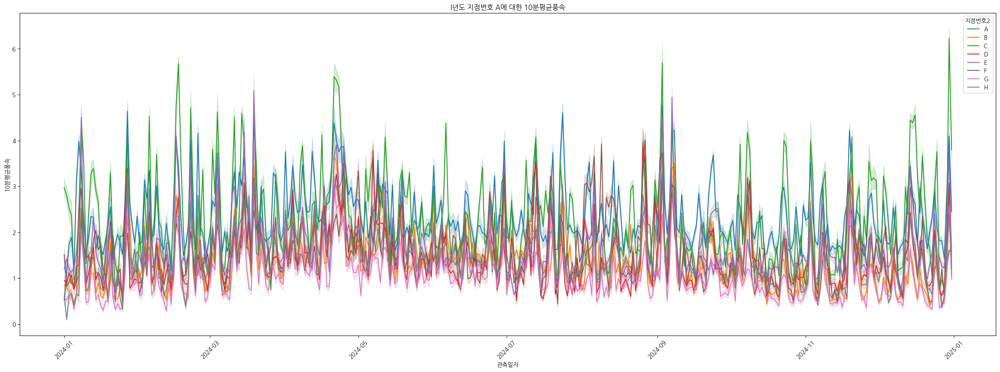

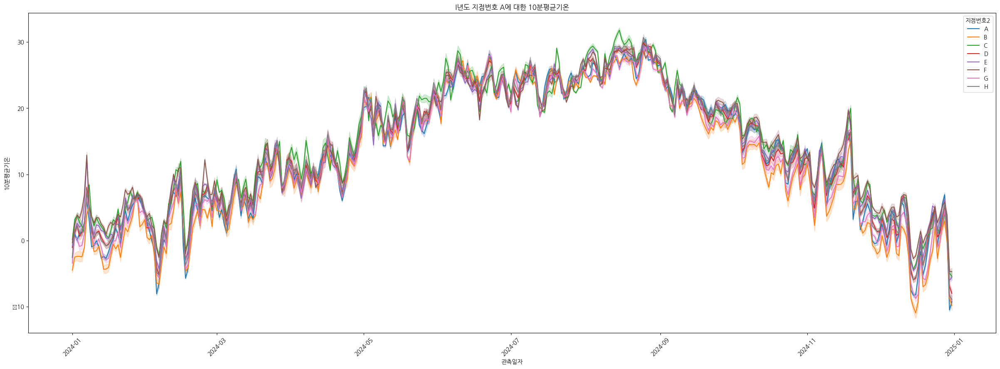

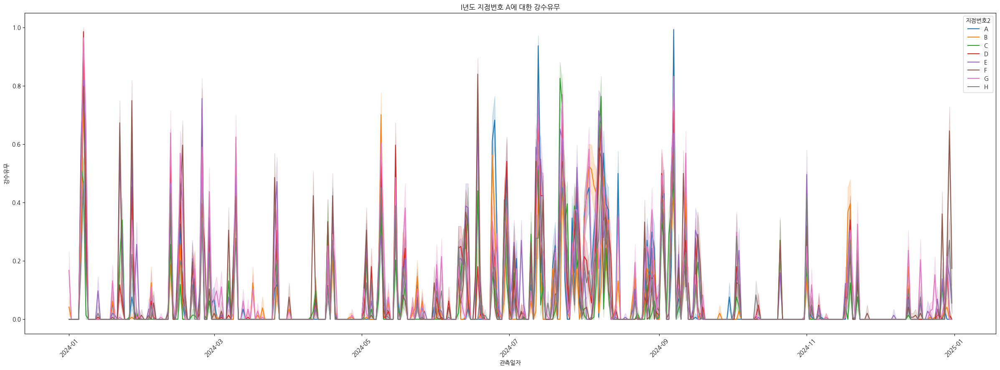

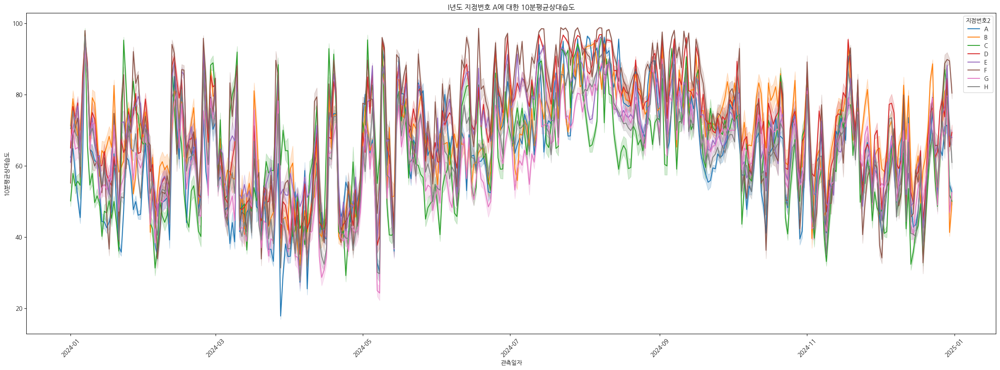

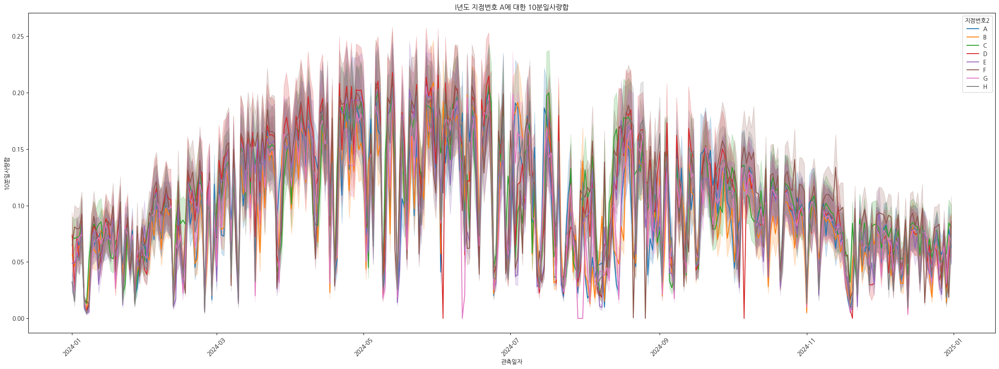

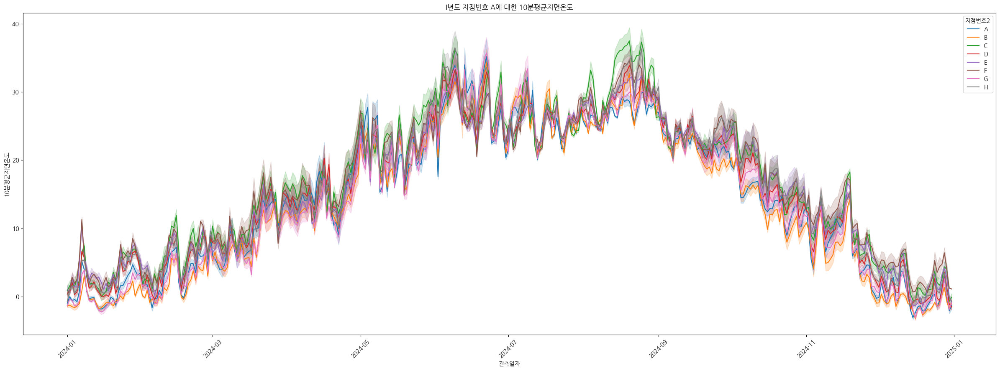

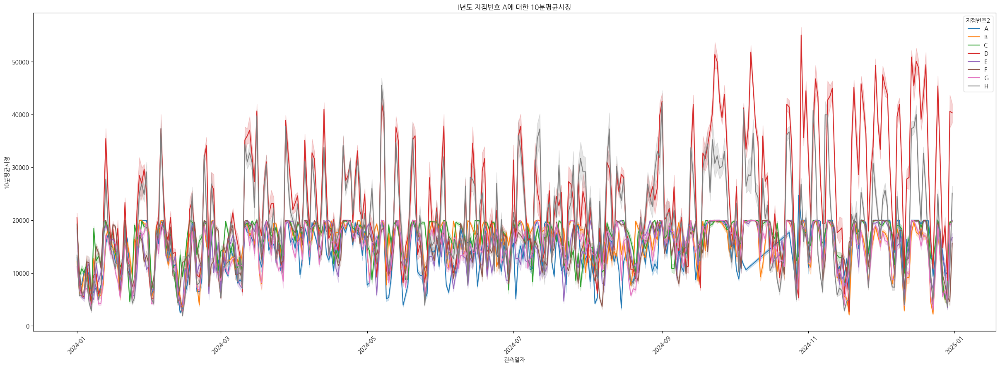

In [33]:
for col in columns :
    plt.figure(figsize=(30, 10))
    plt.title(f"I년도 지점번호 A에 대한 {col}")
    plt.xticks(rotation=45)
    display(sns.lineplot(train_year_I[train_year_I["지점번호1"]=="A"], x="관측일자", y=col, hue="지점번호2"))

<Axes: xlabel='관측일자', ylabel='10분평균시정'>

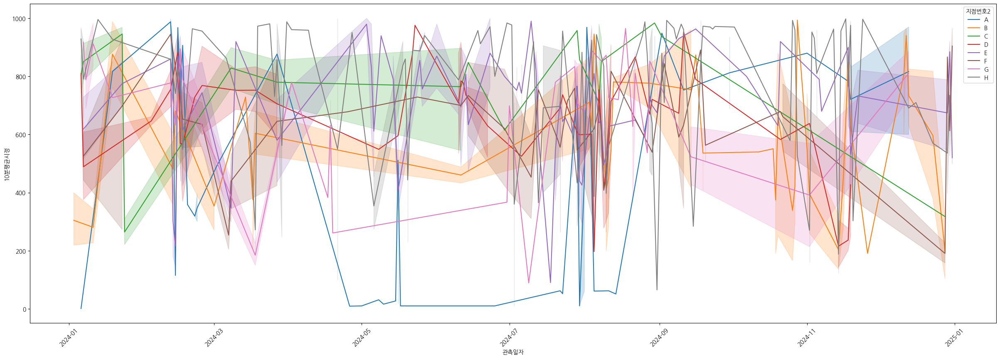

In [34]:
plt.figure(figsize=(30, 10))
plt.xticks(rotation=45)
sns.lineplot(train_year_I[(train_year_I["지점번호1"]=="A")&(train_year_I["10분평균시정"] <= 1000)], x="관측일자", y="10분평균시정", hue="지점번호2")

In [35]:
train_I_spring = train.query("년도=='I' and 계절=='봄' and 지점번호1=='A'")
train_I_spring

,년도,월,일,시간,분,지점번호,10분평균풍향,10분평균풍속,10분평균기온,강수유무,...,10분일사량합,10분평균지면온도,10분평균시정,시정구간,지점번호1,지점번호2,관측일자,관측시간,관측시분,계절
8639,I,3,1,0,0,AA,279.0,1.5,5.3,0.0,...,0.0,2.5,12208.0,4.0,A,A,2024-03-01,2024-03-01 00:00:00,2024-03-01 00:00:00,봄
8640,I,3,1,0,10,AA,272.7,2.1,5.4,0.0,...,0.0,2.7,13762.0,4.0,A,A,2024-03-01,2024-03-01 00:00:00,2024-03-01 00:10:00,봄
8641,I,3,1,0,20,AA,272.3,1.9,5.4,0.0,...,0.0,2.7,12899.0,4.0,A,A,2024-03-01,2024-03-01 00:00:00,2024-03-01 00:20:00,봄
8642,I,3,1,0,30,AA,283.4,1.4,5.2,0.0,...,0.0,2.5,12077.0,4.0,A,A,2024-03-01,2024-03-01 00:00:00,2024-03-01 00:30:00,봄
8643,I,3,1,0,40,AA,261.7,1.5,5.2,0.0,...,0.0,2.5,12752.0,4.0,A,A,2024-03-01,2024-03-01 00:00:00,2024-03-01 00:40:00,봄
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390803,I,5,31,23,10,AH,297.3,0.9,21.0,0.0,...,0.0,22.2,9090.0,4.0,A,H,2024-05-31,2024-05-31 23:00:00,2024-05-31 23:10:00,봄
390804,I,5,31,23,20,AH,275.6,1.4,21.0,0.0,...,0.0,22.1,9090.0,4.0,A,H,2024-05-31,2024-05-31 23:00:00,2024-05-31 23:20:00,봄
390805,I,5,31,23,30,AH,277.5,1.4,21.0,0.0,...,0.0,22.1,9262.0,4.0,A,H,2024-05-31,2024-05-31 23:00:00,2024-05-31 23:30:00,봄
390806,I,5,31,23,40,AH,277.0,1.1,21.1,0.0,...,0.0,22.1,9494.0,4.0,A,H,2024-05-31,2024-05-31 23:00:00,2024-05-31 23:40:00,봄


In [36]:
fig1 = px.line(train_I_spring, x = "관측시분", y = "10분평균풍향", color = "지점번호2", markers=True)
fig1

In [37]:
fig2 = px.line(train_I_spring, x = "관측시분", y = "10분평균풍속", color = "지점번호2", markers=True)
fig2

In [38]:
fig3 = px.line(train_I_spring, x = "관측시분", y = "10분평균상대습도", color = "지점번호2", markers=True)
fig3

In [39]:
fig4 = px.line(train_I_spring, x = "관측시분", y = "10분평균시정", color = "지점번호2", markers=True)
fig4

In [40]:
train_I_spring_time = train_I_spring.groupby(['관측시간', '지점번호'])['10분평균풍향'].mean().reset_index()
train_I_spring_time

,관측시간,지점번호,10분평균풍향
0,2024-03-01 00:00:00,AA,268.516667
1,2024-03-01 00:00:00,AB,214.883333
2,2024-03-01 00:00:00,AC,113.266667
3,2024-03-01 00:00:00,AD,172.566667
4,2024-03-01 00:00:00,AE,100.616667
...,...,...,...
17659,2024-05-31 23:00:00,AD,132.550000
17660,2024-05-31 23:00:00,AE,246.466667
17661,2024-05-31 23:00:00,AF,215.533333
17662,2024-05-31 23:00:00,AG,222.583333


In [41]:
fig2 = px.line(train_I_spring_time, x="관측시간", y="10분평균풍향", color="지점번호")
fig2

In [42]:
train_year_I

,년도,월,일,시간,분,지점번호,10분평균풍향,10분평균풍속,10분평균기온,강수유무,...,10분일사량합,10분평균지면온도,10분평균시정,시정구간,지점번호1,지점번호2,관측일자,관측시간,관측시분,계절
0,I,1,1,0,10,AA,0.0,0.0,-6.4,0.0,...,0.0,-2.8,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:10:00,겨울
1,I,1,1,0,20,AA,0.0,0.0,-6.3,0.0,...,0.0,-2.7,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:20:00,겨울
2,I,1,1,0,30,AA,0.0,0.0,-6.3,0.0,...,0.0,-2.6,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:30:00,겨울
3,I,1,1,0,40,AA,27.8,0.4,-6.2,0.0,...,0.0,-2.6,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:40:00,겨울
4,I,1,1,0,50,AA,59.7,0.5,-6.1,0.0,...,0.0,-2.5,20000.0,4.0,A,A,2024-01-01,2024-01-01 00:00:00,2024-01-01 00:50:00,겨울
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1054055,I,12,31,23,10,EC,260.9,5.9,-0.3,0.0,...,0.0,-1.7,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:10:00,겨울
1054056,I,12,31,23,20,EC,264.3,5.5,-0.3,0.0,...,0.0,-1.7,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:20:00,겨울
1054057,I,12,31,23,30,EC,258.7,5.3,-0.2,0.0,...,0.0,-1.3,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:30:00,겨울
1054058,I,12,31,23,40,EC,263.6,5.7,-0.1,0.0,...,0.0,-1.1,20000.0,4.0,E,C,2024-12-31,2024-12-31 23:00:00,2024-12-31 23:40:00,겨울


In [43]:
train_I_spring_time_piv = pd.pivot_table(train_I_spring,
                                         index = "관측시간",
                                         columns = "지점번호",
                                         values = "10분평균풍향",
                                         aggfunc= 'mean')

In [44]:
train_I_spring_time_piv.corr()

지점번호,AA,AB,AC,AD,AE,AF,AG,AH
지점번호,,,,,,,,
AA,1.000000,0.061963,0.310274,0.155708,0.413891,0.332625,0.440666,0.480651
AB,0.061963,1.000000,0.016513,-0.026149,0.063803,0.117442,0.150035,0.118785
AC,0.310274,0.016513,1.000000,0.140906,0.342093,0.242671,0.299560,0.266264
AD,0.155708,-0.026149,0.140906,1.000000,0.214044,-0.028333,0.024383,0.164106
AE,0.413891,0.063803,0.342093,0.214044,1.000000,0.356412,0.443851,0.300993
AF,0.332625,0.117442,0.242671,-0.028333,0.356412,1.000000,0.321498,0.268421
AG,0.440666,0.150035,0.299560,0.024383,0.443851,0.321498,1.000000,0.351990
AH,0.480651,0.118785,0.266264,0.164106,0.300993,0.268421,0.351990,1.000000


<Axes: xlabel='지점번호', ylabel='지점번호'>

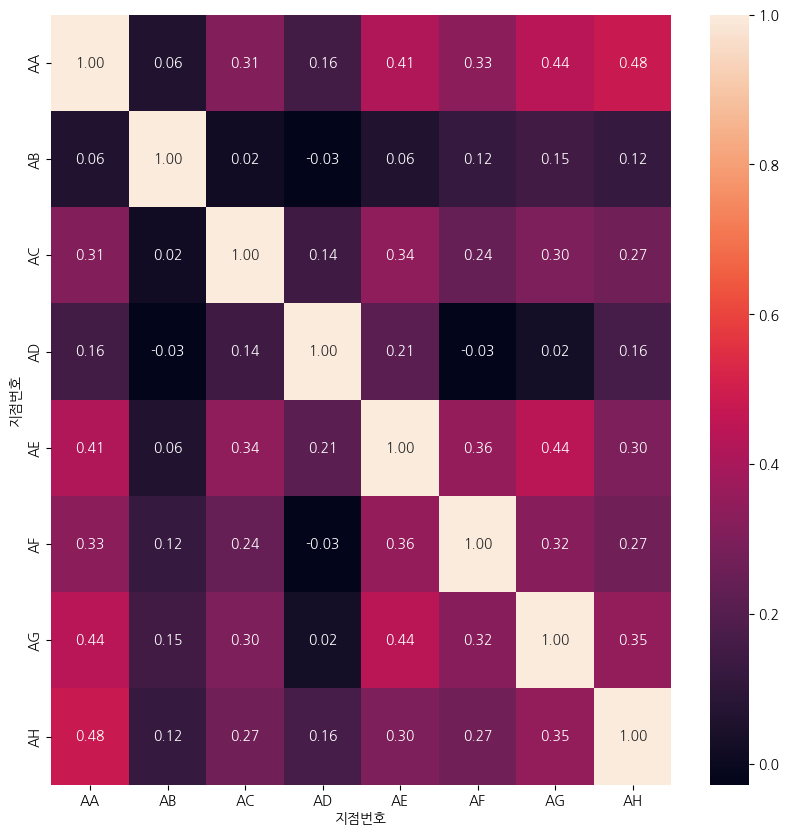

In [45]:
plt.figure(figsize=(10, 10))
sns.heatmap(train_I_spring_time_piv.corr(), annot=True, fmt='.2f')

In [46]:
train_I_spring_time_corr = train_I_spring_time_piv.corr()
train_I_spring_time_corr = train_I_spring_time_corr[(train_I_spring_time_corr >= 0.3) | (train_I_spring_time_corr <= -0.3)]

In [47]:
train_I_spring_time_corr

지점번호,AA,AB,AC,AD,AE,AF,AG,AH
지점번호,,,,,,,,
AA,1.000000,NaN,0.310274,NaN,0.413891,0.332625,0.440666,0.480651
AB,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
AC,0.310274,NaN,1.000000,NaN,0.342093,NaN,NaN,NaN
AD,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN
AE,0.413891,NaN,0.342093,NaN,1.000000,0.356412,0.443851,0.300993
AF,0.332625,NaN,NaN,NaN,0.356412,1.000000,0.321498,NaN
AG,0.440666,NaN,NaN,NaN,0.443851,0.321498,1.000000,0.351990
AH,0.480651,NaN,NaN,NaN,0.300993,NaN,0.351990,1.000000


In [48]:
# correlation matrix 의 diagonal 을 제외한 upper triangle 값을 추출합니다.
upper_triangle = train_I_spring_time_corr.where(np.triu(np.ones(train_I_spring_time_corr.shape), k=1).astype(bool))

In [49]:
# (NxN) -> (N^2 X 1) 로 변환(stack) 후, pandas dataframe 을 만듭니다. 
correlation_df = upper_triangle.stack().to_frame()

In [50]:
correlation_df.index.names = ['지점번호1', '지점번호2']

In [51]:
correlation_df = correlation_df.reset_index().rename(columns={0:"상관계수"})

In [52]:
def split(data):
    return data[0], data[-1]

In [53]:
correlation_df["지점번호1-1"], correlation_df["지점번호1-2"]= zip(*correlation_df["지점번호1"].apply(split))
correlation_df["지점번호2-1"], correlation_df["지점번호2-2"]= zip(*correlation_df["지점번호2"].apply(split))

In [54]:
correlation_df.columns

Index(['지점번호1', '지점번호2', '상관계수', '지점번호1-1', '지점번호1-2', '지점번호2-1', '지점번호2-2'], dtype='object')

In [55]:
correlation_df = correlation_df[['지점번호1', '지점번호1-1', '지점번호1-2', '지점번호2', '지점번호2-1', '지점번호2-2', '상관계수']]

In [56]:
correlation_df.sort_values("상관계수", ascending=False).head(50)

,지점번호1,지점번호1-1,지점번호1-2,지점번호2,지점번호2-1,지점번호2-2,상관계수
4,AA,A,A,AH,A,H,0.480651
7,AE,A,E,AG,A,G,0.443851
3,AA,A,A,AG,A,G,0.440666
1,AA,A,A,AE,A,E,0.413891
6,AE,A,E,AF,A,F,0.356412
10,AG,A,G,AH,A,H,0.351990
5,AC,A,C,AE,A,E,0.342093
2,AA,A,A,AF,A,F,0.332625
9,AF,A,F,AG,A,G,0.321498
0,AA,A,A,AC,A,C,0.310274


<Axes: xlabel='지점번호1-2', ylabel='상관계수'>

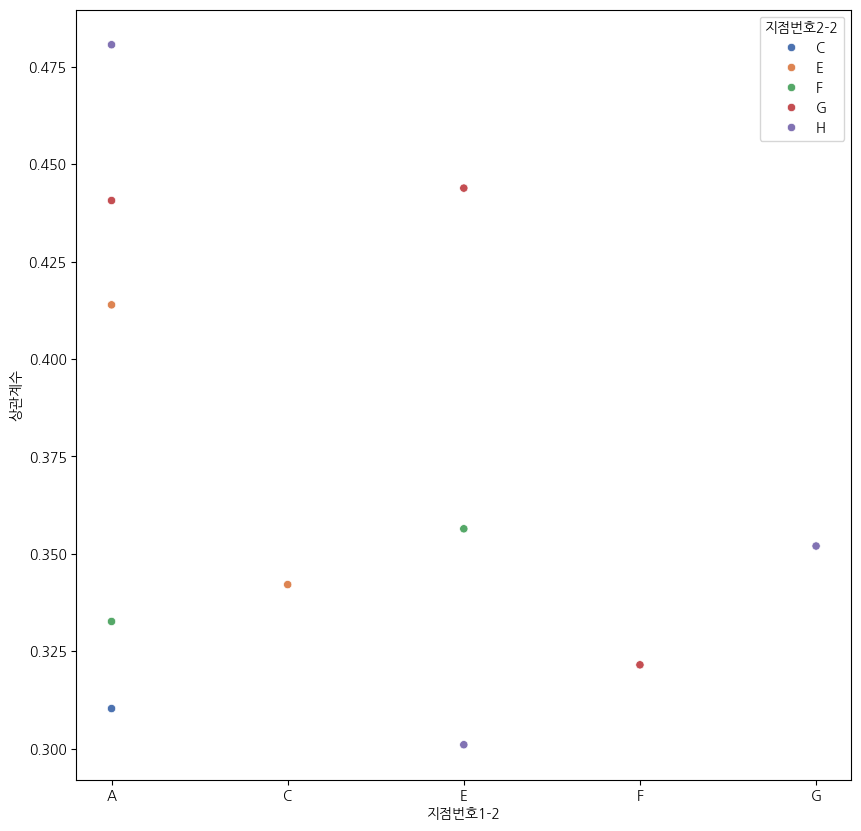

In [58]:
plt.figure(figsize=(10, 10))
plt.legend(labels = sorted(correlation_df["지점번호2-2"].unique()))
sns.scatterplot(correlation_df, x="지점번호1-2", y="상관계수", hue="지점번호2-2", palette="deep")